In [1]:
from SpaCy import *

/home/adrien-escoda/miniconda3/envs/HN/lib/python3.6/site-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


# Tokénisation, lemmatisation et étiquetage du corpus avec spaCy

In [2]:
nlp_corpus('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

[ Matin derniers télégrammes nuit Gallica blende honneur êher Rime chôsè expliquer estiïiènie lionneur plaisir fête tort raison savez situation contrarie autant respect porte affection lie amis ministère vraiment grand dommage soyez justement antiministériel amis pouvoir tôt tard aurais heureux antiministériel adversaires croyez Ranc fertilité imagination bienveillance prête grand simpliste politique crois faut soutenir amis combattre adversaires adversaire séduire ami blesser choix question sentiment illustre homme Etat sais Benjamin Constant Georges Laguerre jour politique baccara mauvaise affaire miser tableaux tait avis joue jamais tableau tableau gauche pensiez Ranc exemple entendu Camille Pelletan droit faire leçon fréquentez adversaires simple plaisir changer compagnie êtes vieux routier politique connaissiez monde faire connaître faut pensez faire œuvre utile faut soyez pénétré service cause pris attitude sûr dû coûter flatter pensez articles remarqués reproduits ministère mal 

# Description générale

In [5]:
#dictionnaire du nombre de tokens par fichier
tokens_file = words_file('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

In [8]:
tokens_file

{'10-09': 5667,
 '10-27': 5789,
 '02-12': 4973,
 '06-09': 5564,
 '03-13': 5566,
 '08-18': 5460,
 '09-19': 5640,
 '05-19': 5330,
 '03-07': 5167,
 '07-05': 6010,
 '12-14': 5788,
 '03-20': 5315,
 '08-21': 5338,
 '02-17': 5122,
 '03-11': 5023,
 '08-30': 5363,
 '01-30': 5321,
 '11-12': 5319,
 '11-23': 5527,
 '06-21': 5824,
 '04-16': 5238,
 '07-12': 5746,
 '11-13': 5164,
 '05-28': 5199,
 '10-10': 5673,
 '07-03': 5455,
 '01-19': 4870,
 '10-18': 5834,
 '10-22': 5522,
 '06-10': 5681,
 '04-08': 5252,
 '10-01': 4330,
 '07-01': 5477,
 '11-14': 5693,
 '08-27': 5652,
 '01-07': 4818,
 '08-07': 5481,
 '03-24': 5062,
 '06-08': 5229,
 '03-18': 5247,
 '05-26': 5329,
 '12-06': 5456,
 '01-16': 5336,
 '10-24': 5615,
 '04-10': 5100,
 '04-19': 5057,
 '02-18': 4755,
 '10-14': 5808,
 '05-23': 5793,
 '09-13': 5439,
 '10-28': 5863,
 '01-03': 5564,
 '06-01': 5752,
 '01-25': 4901,
 '10-26': 6018,
 '12-02': 5602,
 '04-26': 5048,
 '02-14': 4970,
 '05-14': 5271,
 '06-06': 5551,
 '10-31': 5577,
 '04-05': 5336,
 '01-31'

In [6]:
#somme du nombre total de tokens dans le corpus
print(sum(tokens_file.values()))

1944128


In [7]:
#nombre moyen de tokens par fichier
np.array(list(tokens_file.values())).mean()

5326.378082191781

In [9]:
#ombre moyen de tokens par fichier en excluant les valeurs scélérates : 06-28 ; 07-22 ; 11-03
tokens_file_2 = {'10-09': 5667, '10-27': 5789, '02-12': 4973, '06-09': 5564, '03-13': 5566, '08-18': 5460, '09-19': 5640, '05-19': 5330, '03-07': 5167, '07-05': 6010, '12-14': 5788, '03-20': 5315, '08-21': 5338, '02-17': 5122, '03-11': 5023, '08-30': 5363, '01-30': 5321, '11-12': 5319, '11-23': 5527, '06-21': 5824, '04-16': 5238, '07-12': 5746, '11-13': 5164, '05-28': 5199, '10-10': 5673, '07-03': 5455, '01-19': 4870, '10-18': 5834, '10-22': 5522, '06-10': 5681, '04-08': 5252, '10-01': 4330, '07-01': 5477, '11-14': 5693, '08-27': 5652, '01-07': 4818, '08-07': 5481, '03-24': 5062, '06-08': 5229, '03-18': 5247, '05-26': 5329, '12-06': 5456, '01-16': 5336, '10-24': 5615, '04-10': 5100, '04-19': 5057, '02-18': 4755, '10-14': 5808, '05-23': 5793, '09-13': 5439, '10-28': 5863, '01-03': 5564, '06-01': 5752, '01-25': 4901, '10-26': 6018, '12-02': 5602, '04-26': 5048, '02-14': 4970, '05-14': 5271, '06-06': 5551, '10-31': 5577, '04-05': 5336, '01-31': 4928, '05-18': 5482, '09-30': 5265, '04-22': 5195, '08-23': 5364, '06-22': 5470, '12-16': 5926, '10-05': 5350, '05-21': 5259, '03-22': 5188, '02-15': 4865, '02-27': 4892, '02-16': 5016, '04-17': 5467, '01-15': 4999, '06-19': 5324, '01-18': 4958, '09-21': 5401, '04-02': 5254, '05-12': 5452, '07-11': 5647, '12-13': 5577, '03-12': 4467, '05-04': 5594, '09-22': 5548, '09-17': 5137, '03-28': 5131, '02-01': 4868, '02-06': 5295, '05-22': 5293, '02-23': 4943, '11-02': 5380, '06-23': 5366, '08-24': 5712, '07-20': 5367, '11-18': 5484, '11-09': 6007, '05-10': 5659, '06-17': 5481, '07-29': 5475, '10-16': 5364, '05-30': 5540, '10-15': 5501, '07-27': 5550, '07-17': 5504, '10-19': 5828, '08-25': 5419, '08-09': 5575, '03-19': 4951, '03-21': 5217, '08-02': 5335, '05-02': 5709, '03-01': 5177, '03-08': 5162, '09-01': 5363, '09-16': 5896, '06-16': 5161, '12-17': 5314, '11-10': 5647, '10-30': 5204, '02-25': 4905, '06-30': 5554, '01-17': 5049, '02-08': 5017, '07-21': 5554, '09-08': 5646, '12-10': 5194, '10-06': 5425, '02-02': 5197, '07-10': 5666, '06-03': 5117, '03-25': 5233, '06-27': 5801, '02-19': 4596, '08-28': 5122, '08-11': 5162, '12-09': 5636, '09-11': 5320, '01-05': 4876, '03-06': 5428, '02-11': 4922, '02-26': 4797, '08-19': 5856, '03-23': 5012, '10-20': 5372, '01-09': 4988, '06-11': 5415, '01-20': 4711, '12-30': 5388, '09-24': 5716, '01-29': 4836, '03-30': 5194, '12-21': 5685, '01-04': 4911, '03-27': 5001, '03-15': 5684, '12-08': 5494, '09-25': 5467, '03-03': 5043, '12-12': 5534, '03-29': 5058, '05-25': 5407, '04-12': 5046, '08-17': 5572, '05-03': 5529, '10-07': 5512, '06-26': 5444, '09-07': 5614, '11-28': 5439, '07-06': 5689, '12-28': 5881, '08-04': 5418, '01-28': 5034, '05-09': 4733, '10-21': 5329, '01-10': 5145, '01-02': 4966, '08-16': 5141, '09-28': 5340, '11-07': 5490, '03-17': 5616, '11-26': 5706, '08-08': 5820, '07-02': 5390, '07-16': 5521, '10-11': 5816, '12-19': 5566, '02-20': 4983, '02-13': 4906, '11-17': 5319, '08-15': 5794, '05-20': 5555, '11-15': 5511, '08-13': 5755, '04-01': 5342, '07-30': 5414, '12-04': 5801, '03-16': 5574, '12-31': 5340, '12-15': 5423, '12-24': 5253, '07-14': 5699, '04-24': 5397, '09-23': 5761, '01-21': 5008, '07-25': 5994, '04-30': 5160, '10-23': 5150, '11-29': 5171, '12-22': 5619, '03-14': 5260, '08-01': 5502, '07-15': 5485, '05-31': 5899, '07-13': 5361, '02-28': 4831, '04-04': 5018, '04-28': 5205, '08-31': 5152, '01-08': 4742, '04-06': 5263, '11-06': 5376, '09-05': 5552, '07-04': 6092, '12-27': 5938, '06-02': 5546, '07-26': 5273, '06-15': 5420, '03-02': 5973, '02-24': 4855, '08-03': 5783, '02-09': 4910, '12-07': 5245, '07-28': 5661, '08-22': 5570, '08-26': 5395, '07-08': 5373, '07-19': 5563, '11-24': 5732, '08-20': 5455, '09-20': 5621, '09-02': 5147, '04-23': 5393, '12-20': 5295, '05-08': 5679, '12-23': 5628, '12-26': 5904, '06-25': 5232, '04-29': 5274, '10-02': 5355, '01-23': 4801, '07-07': 5731, '11-30': 5354, '06-04': 5427, '01-24': 4909, '04-27': 5271, '10-25': 5526, '01-11': 5064, '12-29': 5564, '01-27': 4740, '02-22': 4785, '11-20': 5837, '11-08': 5515, '04-25': 5175, '10-03': 5516, '01-01': 4908, '06-18': 5132, '04-11': 5260, '04-07': 5675, '02-07': 5168, '05-05': 6009, '10-04': 5331, '11-04': 5776, '07-18': 5637, '04-21': 5139, '11-19': 5262, '05-13': 5384, '09-06': 5388, '02-21': 4983, '09-04': 5622, '06-20': 5641, '06-14': 5441, '06-12': 5699, '06-05': 5642, '07-31': 5374, '04-18': 5433, '05-15': 5331, '07-23': 5420, '01-06': 4759, '05-06': 5621, '09-15': 5677, '04-03': 5185, '11-27': 5403, '04-20': 5354, '12-03': 5595, '03-04': 5061, '02-03': 5101, '08-05': 5614, '10-13': 5750, '12-01': 5424, '12-18': 5366, '01-13': 5228, '11-25': 5666, '02-04': 4710, '05-07': 5339, '08-06': 5448, '09-10': 4528, '05-29': 5267, '09-12': 5687, '01-14': 5226, '01-26': 4755, '06-29': 5407, '11-16': 5256, '03-26': 5049, '05-16': 5644, '11-21': 5260, '02-05': 4801, '07-09': 5655, '09-29': 5353, '05-11': 5486, '03-10': 5060, '04-13': 5003, '01-12': 4253, '03-31': 5406, '11-22': 5676, '02-10': 4765, '09-26': 5429, '10-29': 5539, '03-05': 5004, '05-24': 5384, '05-17': 5815, '04-14': 5503, '04-15': 5315, '09-18': 5459, '07-24': 5270, '10-08': 5329, '05-27': 5613, '11-01': 5224, '11-05': 5665, '08-10': 5422, '06-13': 5674, '03-09': 5097, '08-14': 5697, '09-09': 5438, '09-27': 5106, '12-25': 5713, '08-12': 5611, '01-22': 4690, '08-29': 5156, '05-01': 5783, '09-03': 5236, '10-17': 5382, '06-07': 5364, '06-24': 5432, '10-12': 5860, '11-11': 5747, '04-09': 5124, '09-14': 5603, '12-05': 5421, '12-11': 5569}
np.array(list(tokens_file_2.values())).mean()

5366.817679558011

# Entités nomées/Boulanger

## Entités nommées

In [8]:
#compteur d'entités nommées dans le corpus
compteur_personnes = count_per('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

In [9]:
#transformation du compteur en dictionnaire. N'affiche que les entités nommées qui apparaissent 200 fois ou plus
dico_personnes = counter_to_dico(compteur_personnes,200)
dico_personnes

{'Ferry': 244,
 'Rouvier': 665,
 'général Boulanger': 444,
 'Wilson': 453,
 'Grévy': 623,
 'général Ferron': 201,
 'Boulanger': 340,
 'Flourens': 233,
 'Goblet': 461,
 'Bismarck': 720,
 'Franco': 242,
 'Floquet': 209,
 'Guillaume': 275,
 'Carnot': 238,
 'Jules Ferry': 290,
 'Pranzini': 347}

In [19]:
#nombre total d'entités nommées dans le corpus
tot_per('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

76857

In [10]:
#Tri du dictionnaire en fonction des valeurs par ordre décroissant
dico_trie_personnes = tri_dico_decroissant(dico_personnes)
dico_trie_personnes

OrderedDict([('Bismarck', 720),
             ('Rouvier', 665),
             ('Grévy', 623),
             ('Goblet', 461),
             ('Wilson', 453),
             ('général Boulanger', 444),
             ('Pranzini', 347),
             ('Boulanger', 340),
             ('Jules Ferry', 290),
             ('Guillaume', 275),
             ('Ferry', 244),
             ('Franco', 242),
             ('Carnot', 238),
             ('Flourens', 233),
             ('Floquet', 209),
             ('général Ferron', 201)])

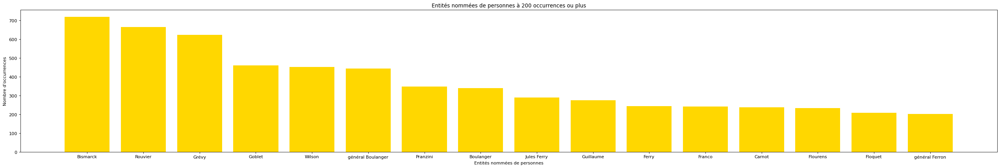

In [12]:
#histogramme des entités nommées les plus fréquentes dans le corpus
fig1 = plt.figure(figsize=(40, 6), dpi=80)
fig1 = plt.bar(list(dico_trie_personnes.keys()), dico_trie_personnes.values(), color='gold')
plt.title('Entités nommées de personnes à 200 occurrences ou plus')
plt.xlabel('Entités nommées de personnes')
plt.ylabel("Nombre d'occurrences")
plt.savefig('ent_per.jpg')

## Boulanger

In [26]:
#Décompte du nombre d'occurrences des entités nommées les plus fréquentes relatives au général 
#('Boulanger', 'général Boulanger, 'Vive Boulanger') par fichier pour l'ensemble du corpus
dico_ent_boulanger = boulanger_ent_fichier('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

In [27]:
#affichage du nombre total d'entités nommées "Boulanger"
print(sum(dico_ent_boulanger.values()))

784


In [29]:
#Décompte du nombre de tokens "Boulanger" par fichier pour l'ensemble du copus
dico_token_boulanger = boulanger_token_fichier('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')
dico_token_boulanger

{'10-09': 9,
 '10-27': 1,
 '02-12': 6,
 '06-09': 0,
 '03-13': 2,
 '08-18': 0,
 '09-19': 2,
 '05-19': 19,
 '03-07': 1,
 '07-05': 0,
 '12-14': 0,
 '03-20': 2,
 '08-21': 1,
 '02-17': 2,
 '03-11': 0,
 '08-30': 0,
 '01-30': 1,
 '11-12': 6,
 '11-23': 1,
 '06-21': 1,
 '04-16': 0,
 '07-12': 16,
 '11-13': 2,
 '05-28': 3,
 '10-10': 6,
 '07-03': 2,
 '01-19': 6,
 '10-18': 5,
 '10-22': 1,
 '06-10': 4,
 '04-08': 0,
 '10-01': 0,
 '07-01': 1,
 '11-14': 13,
 '08-27': 4,
 '01-07': 3,
 '08-07': 4,
 '03-24': 10,
 '06-08': 0,
 '03-18': 8,
 '05-26': 2,
 '12-06': 0,
 '01-16': 1,
 '10-24': 0,
 '04-10': 1,
 '04-19': 0,
 '02-18': 1,
 '10-14': 25,
 '05-23': 6,
 '09-13': 0,
 '10-28': 0,
 '01-03': 3,
 '06-01': 21,
 '01-25': 16,
 '10-26': 0,
 '12-02': 9,
 '04-26': 1,
 '02-14': 0,
 '05-14': 0,
 '06-06': 5,
 '10-31': 0,
 '04-05': 1,
 '01-31': 0,
 '05-18': 6,
 '09-30': 1,
 '04-22': 0,
 '08-23': 0,
 '06-22': 5,
 '12-16': 0,
 '10-05': 2,
 '05-21': 2,
 '03-22': 0,
 '02-15': 1,
 '02-27': 2,
 '02-16': 2,
 '04-17': 1,
 '01-

In [30]:
#affichage du nombre total de tokens "Boulanger"
print(sum(dico_token_boulanger.values()))

1120


In [31]:
#Décompte du nombre de fichiers à n occurrences du token 'Boulanger'
decompte_boulanger = dico_to_decompte(dico_token_boulanger)
decompte_boulanger

OrderedDict([(0, 136),
             (1, 67),
             (2, 51),
             (3, 24),
             (4, 14),
             (5, 12),
             (6, 13),
             (7, 7),
             (8, 3),
             (9, 8),
             (10, 4),
             (11, 3),
             (12, 4),
             (13, 4),
             (16, 2),
             (17, 1),
             (18, 1),
             (19, 1),
             (20, 1),
             (21, 1),
             (23, 1),
             (25, 2),
             (26, 1),
             (29, 1),
             (34, 1),
             (37, 1),
             (41, 1)])

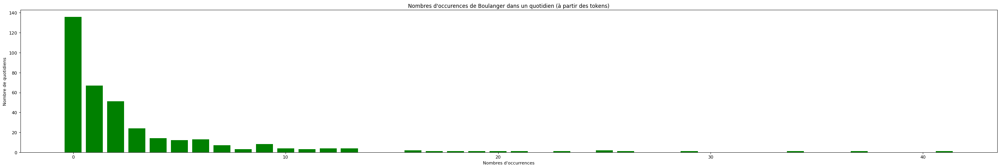

In [32]:
#Histogramme du décompte du nombre de fichiers à n occurrences du token 'Boulanger'
fig2 = plt.figure(figsize=(40, 6), dpi=80)
fig2 = plt.bar(list(decompte_boulanger.keys()), decompte_boulanger.values(), color='g')
plt.title("Nombres d'occurences de Boulanger dans un quotidien (à partir des tokens)")
plt.xlabel("Nombres d'occurrences")
plt.ylabel("Nombre de quotidiens")
plt.savefig('boulanger_1887_token.jpg')

In [33]:
#tri du dictionnaire par date
dico_trie_boulanger = tri_dico_date(dico_token_boulanger)
dico_trie_boulanger

OrderedDict([('01-01', 0),
             ('01-02', 2),
             ('01-03', 3),
             ('01-04', 1),
             ('01-05', 5),
             ('01-06', 2),
             ('01-07', 3),
             ('01-08', 4),
             ('01-09', 2),
             ('01-10', 12),
             ('01-11', 0),
             ('01-12', 2),
             ('01-13', 7),
             ('01-14', 0),
             ('01-15', 4),
             ('01-16', 1),
             ('01-17', 3),
             ('01-18', 0),
             ('01-19', 6),
             ('01-20', 1),
             ('01-21', 6),
             ('01-22', 7),
             ('01-23', 3),
             ('01-24', 9),
             ('01-25', 16),
             ('01-26', 3),
             ('01-27', 2),
             ('01-28', 4),
             ('01-29', 0),
             ('01-30', 1),
             ('01-31', 0),
             ('02-01', 4),
             ('02-02', 10),
             ('02-03', 3),
             ('02-04', 6),
             ('02-05', 13),
             ('02-06', 1

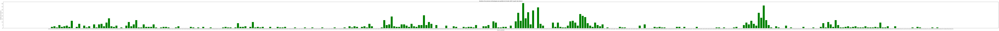

In [34]:
#histogramme du nombre d'occurrences du token "Boulanger" par date
fig_5 = plt.figure(figsize=(220, 6), dpi=80)
fig_5 = plt.bar(list(dico_trie_boulanger.keys()), dico_trie_boulanger.values(), color='g')
plt.title("Nombres d'occurences de Boulanger par quotidien de l'année 1887 (à partir des tokens)")
plt.xlabel("Date du quotidien")
plt.ylabel("Nombre d'occurrences")
plt.savefig('boulanger_par_quotidien_token.jpg')

# word2vec

In [3]:
#construction d'une liste de listes de string afin d'entraîner le modèle 
sentences = strings_to_liste('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')
sentences

[['Matin',
  'derniers',
  'télégrammes',
  'nuit',
  'Gallica',
  'blende',
  'honneur',
  'êher',
  'Rime',
  'chôsè',
  'expliquer',
  'estiïiènie',
  'lionneur',
  'plaisir',
  'fête',
  'tort',
  'raison',
  'savez',
  'situation',
  'contrarie',
  'autant',
  'respect',
  'porte',
  'affection',
  'lie',
  'amis',
  'ministère',
  'vraiment',
  'grand',
  'dommage',
  'soyez',
  'justement',
  'antiministériel',
  'amis',
  'pouvoir',
  'tôt',
  'tard',
  'aurais',
  'heureux',
  'antiministériel',
  'adversaires',
  'croyez',
  'Ranc',
  'fertilité',
  'imagination',
  'bienveillance',
  'prête',
  'grand',
  'simpliste',
  'politique',
  'crois',
  'faut',
  'soutenir',
  'amis',
  'combattre',
  'adversaires',
  'adversaire',
  'séduire',
  'ami',
  'blesser',
  'choix',
  'question',
  'sentiment',
  'illustre',
  'homme',
  'Etat',
  'sais',
  'Benjamin',
  'Constant',
  'Georges',
  'Laguerre',
  'jour',
  'politique',
  'baccara',
  'mauvaise',
  'affaire',
  'miser',
  't

In [4]:
#construction du modèle avec une taille de contexte de 5
model_lematin = Word2Vec(sentences, vector_size=200, window=5, epochs=10, sg=1, min_count= 5, workers=4)

In [13]:
model_lematin.wv.most_similar(['Boulanger'])

[('général', 0.7400652766227722),
 ('Ferron', 0.6546139717102051),
 ('Campenon', 0.554462194442749),
 ('Caffarel', 0.5476473569869995),
 ('Saussier', 0.5348327159881592),
 ('Bou', 0.5328830480575562),
 ('Thibaudin', 0.5298957228660583),
 ('lange', 0.5213610529899597),
 ('Géraudel', 0.5120633840560913),
 ('Laur', 0.5072336196899414)]

In [42]:
model_lematin.wv.most_similar(['bonapartiste','Boulanger'])

[('boulangistes', 0.648832380771637),
 ('modérantisme', 0.6432985067367554),
 ('général', 0.6418592929840088),
 ('Lareinty', 0.6394252777099609),
 ('Ducrot', 0.6379572153091431),
 ('genéral', 0.6297518610954285),
 ('échauffé', 0.6277552247047424),
 ('Appert', 0.6205140352249146),
 ('Lherminier', 0.6190225481987),
 ('Campenon', 0.6165099143981934)]

In [52]:
model_lematin.wv.most_similar(['Boulanger', 'monarchistes'])

[('Républiqne', 0.6402148008346558),
 ('opportunistes', 0.6388193964958191),
 ('modérantisme', 0.6346015930175781),
 ('boulangistes', 0.6325921416282654),
 ('radicalisme', 0.63001948595047),
 ('inconséquence', 0.6261537671089172),
 ('intransigeance', 0.6215416789054871),
 ('départager', 0.6110206246376038),
 ('rééditer', 0.6102887392044067),
 ('déchaînées', 0.6063173413276672)]

In [17]:
model_lematin.wv.most_similar(['général'])

[('Ferron', 0.744306206703186),
 ('Boulanger', 0.7400652766227722),
 ('Caffarel', 0.630424976348877),
 ('générai', 0.6098820567131042),
 ('Thibaudin', 0.5830802321434021),
 ('Lewal', 0.577262818813324),
 ('néral', 0.5749418139457703),
 ('Bellemare', 0.542921781539917),
 ('Andlau', 0.5401672720909119),
 ('Campenon', 0.5392035841941833)]

In [5]:
#construction du modèle avec une taille de contexte de 25
model_lematin_2 = Word2Vec(sentences, vector_size=200, window=25, epochs=10, sg=1, min_count= 5, workers=4)

In [31]:
model_lematin_2.wv.most_similar(['Boulanger'])

[('général', 0.6559820771217346),
 ('boulangistes', 0.6167107820510864),
 ('Ferron', 0.5692033171653748),
 ('Peaucellier', 0.5481889843940735),
 ('boulangiste', 0.5428686141967773),
 ('Lewal', 0.5336205959320068),
 ('SaintArnaud', 0.5319085717201233),
 ('Thibaudin', 0.5283156037330627),
 ('ClermontFerrand', 0.519155740737915),
 ('exministre', 0.5136644840240479)]

In [44]:
model_lematin_2.wv.most_similar(['bonapartiste','Boulanger'])

[('Lareinty', 0.5612871050834656),
 ('général', 0.5557384490966797),
 ('Schmitz', 0.5548707246780396),
 ('Lalou', 0.541592001914978),
 ('providentiel', 0.534907341003418),
 ('boulangistes', 0.5302249193191528),
 ('boulangiste', 0.521689772605896),
 ('genéral', 0.5053277611732483),
 ('césarisme', 0.5045151710510254),
 ('LoireInférieure', 0.5037518739700317)]

In [46]:
model_lematin_2.wv.most_similar(['Boulanger', 'monarchistes'])

[('boulangistes', 0.6313128471374512),
 ('Droite', 0.5813302993774414),
 ('républicains', 0.5753127932548523),
 ('modérantisme', 0.5630757212638855),
 ('radicaux', 0.5609707236289978),
 ('providentiel', 0.5603969097137451),
 ('ExtrêmeGauche', 0.5529002547264099),
 ('SaintArnaud', 0.5474733114242554),
 ('impénitents', 0.5472890138626099),
 ('intransigeance', 0.5353686809539795)]

In [47]:
model_lematin_2.wv.most_similar(['général'])

[('Lewal', 0.6681196689605713),
 ('Boulanger', 0.6559821367263794),
 ('Ferron', 0.6468868255615234),
 ('Larclause', 0.6263923048973083),
 ('Haillot', 0.6156682372093201),
 ('Thomassin', 0.609600841999054),
 ('Berge', 0.5993967652320862),
 ('Peaucellier', 0.5967100262641907),
 ('commandant', 0.5943567156791687),
 ('Millot', 0.5885675549507141)]

In [6]:
#construction du modèle avec une taille de contexte de 50
model_lematin_3 = Word2Vec(sentences, vector_size=200, window=50, epochs=10, sg=1, min_count= 5, workers=4)

In [7]:
#construction du modèle avec une taille de contexte de 2
model_lematin_4 = Word2Vec(sentences, vector_size=200, window=2, epochs=10, sg=1, min_count= 5, workers=4)

In [48]:
###OUBLI DE LA FONCTION DE DECOMPTE D'OCCURRENCES DU TOKEN "boulangistes" dans SpaCy.py
#Fonction qui compte le nombre d'occurrences du token 'boulangistes' pour un fichier
def count_boulangistes(file):
    total_boulanger = 0
    with(open(file, "r", encoding='utf-8')) as f:
        fichier = f.read()
        doc = nlp(fichier)
        for token in doc: 
            if token.text == 'boulangistes':
                total_boulanger += 1
        return total_boulanger

In [49]:
#Fonction qui compte le nombre d'occurrences du token 'boulangistes' pour tout le corpus
def tot_boulangistes(dirname):
    boulangistes = {}
    files = glob.glob(os.path.join(dirname + '/*.txt'))
    for file in files:
        t = filename(file)
        n = count_boulangistes(file)
        boulangistes[t] = n
    return boulangistes

In [50]:
boulangistes = tot_boulangistes('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

In [53]:
print(sum(boulangistes.values()))

24


# NLTK

In [72]:
#rajout de la fonction présente dans le fichier SpaCy.py car pour une raison que nous ignorons, impossible de
#faire appel à la fonction depuis ledit fichier
def liste_de_listes(dirname):
    liste = []
    files = glob.glob(os.path.join(dirname + '/*.txt'))
    for file in files:
        l = nltk_lemmatize(file)
        liste.append(l)
    return liste

In [73]:
#liste de listes de string comprenant mon corpus
liste_de_listes = liste_de_listes('/home/adrien-escoda/Documents/M1HN_version_finale/Corpora/texte_nettoye_pretraite')

In [74]:
#rassemblement en une seule liste tous les strings de mes sous listes
liste_de_strings = flat_list(liste_de_listes)

In [76]:
#calcul des bigrammes les plus fréquents
bigrams_freq = ngrams(liste_de_strings,2)
bigrams_freq

(SERVICE, SPÉCIAL)         2514
(FIL, SPÉCIAL)             1445
(SPÉCIAL, LONDRES)          815
(ministre, guerre)          807
(général, Boulanger)        765
(président, conseil)        753
(président, République)     709
(affaire, étrangères)       544
(point, vue)                526
(hier, soir)                500
dtype: int64

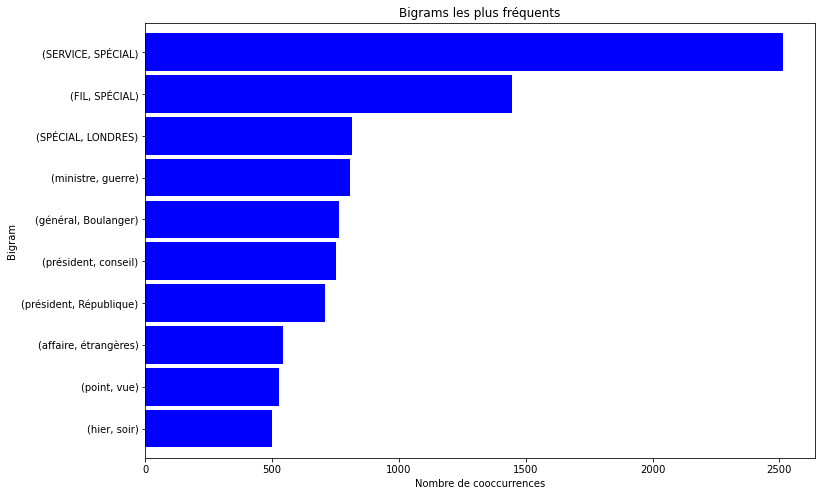

In [77]:
#figure représentant les bigrammes les plus fréquents
bigrams_freq.sort_values().plot.barh(color='blue', width=.9, figsize=(12, 8))
plt.title("Bigrams les plus fréquents")
plt.xlabel("Nombre de cooccurrences")
plt.ylabel("Bigram")
plt.savefig('best_bigrams.jpg')

In [78]:
#bigrammes autour du terme "Boulanger" les plus fréquents à partir de raw_freq
bigrammes_boulanger = bigram_boulanger(liste_de_strings)
bigrammes_boulanger

{('général', 'Boulanger'): 0.00039370220571017443,
 ('Boulanger', 'ministre'): 1.286608515392727e-05,
 ('cris', 'Boulanger'): 1.1836798341613088e-05,
 ('Boulanger', 'général'): 7.205007686199271e-06,
 ('question', 'Boulanger'): 6.69036428004218e-06,
 ('Boulanger', 'ministère'): 5.146434061570908e-06,
 ('Boulanger', 'Ferry'): 4.117147249256726e-06,
 ('Boulanger', 'commission'): 3.6025038430996355e-06,
 ('Boulanger', 'vient'): 3.6025038430996355e-06,
 ('Boulanger', 'faut'): 3.0878604369425446e-06,
 ('Boulanger', 'restera'): 3.0878604369425446e-06,
 ('Général', 'Boulanger'): 3.0878604369425446e-06,
 ('do', 'Boulanger'): 3.0878604369425446e-06,
 ('néral', 'Boulanger'): 3.0878604369425446e-06,
 ('Boulanger', 'Ferron'): 2.573217030785454e-06,
 ('Boulanger', 'faire'): 2.573217030785454e-06,
 ('Boulanger', 'faisait'): 2.573217030785454e-06,
 ('Boulanger', 'homme'): 2.573217030785454e-06,
 ('Boulanger', 'sénateur'): 2.573217030785454e-06,
 ('crier', 'Boulanger'): 2.573217030785454e-06,
 ('Boula

In [79]:
#bigrammes autour du terme "Boulanger" les plus fréquents à partir de likelihood_ratio
bigrammes_boulanger_2 = bigram_boulanger_lh_ratio(liste_de_strings)
bigrammes_boulanger_2

{('général', 'Boulanger'): 7807.034025523202,
 ('cris', 'Boulanger'): 179.9609906441612,
 ('Boulanger', 'ministre'): 69.6323325756166,
 ('néral', 'Boulanger'): 59.84400393984406,
 ('Général', 'Boulanger'): 52.946153490624084,
 ('crier', 'Boulanger'): 35.26644352711526,
 ('Boulanger', 'restera'): 34.13720467260454,
 ('Boulanger', 'Ferry'): 30.201505920439494,
 ('Boulanger', 'jobards'): 29.93976492384993,
 ('crié', 'Boulanger'): 27.077979316611792,
 ('Boulanger', 'aimait'): 22.64821801793915,
 ('Boulanger', 'sénateur'): 22.617475435357278,
 ('question', 'Boulanger'): 22.396667303983623,
 ('Boulanger', 'Ferron'): 21.890662264394685,
 ('Boulanger', 'recevait'): 21.797190960028388,
 ('Boulanger', 'ministère'): 21.696853938953364,
 ('genéral', 'Boulanger'): 21.569601883739963,
 ('Boulanger', 'général'): 21.279822250390847,
 ('Boulanger', 'validé'): 20.949136051797034,
 ('Cluseret', 'Boulanger'): 20.949136051797034,
 ('cri', 'Boulanger'): 20.930173736025967,
 ('lange', 'Boulanger'): 20.412909